In [ ]:
!pip install --upgrade polars
!pip install dataprep


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.3/26.3 MB 32.5 MB/s eta 0:00:00
  Attempting uninstall: polars
    Found existing installation: polars 0.20.2
    Uninstalling polars-0.20.2:
      Successfully uninstalled polars-0.20.2
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.9/9.9 MB 18.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.5/18.5 MB 15.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.6/133.6 kB 15.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 10.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 12.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 11.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 12.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 764.0/764.0 kB 12.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.4/6.4 MB 7.8 MB/s eta 0:00:00
  P

In [ ]:
# **Data processing libraries:**
import pandas as pd  # Data analysis and manipulation
import numpy as np  # Numerical computing
from prophet import Prophet
# **Data cleaning libraries:**
import missingno as msno  # Missing data visualization and imputation
import dataprep.clean  # Data cleaning and preparation
%matplotlib inline
# **Data visualization libraries:**
import seaborn as sns  # Statistical data visualization
import matplotlib.pyplot as plt  # 2D and 3D plotting
import plotly.express as px  # Interactive visualizations
import plotly.graph_objects as go  # Interactive data visualization
import polars as pl
# **Machine learning libraries:**
import sklearn  # Machine learning algorithms
from IPython.core.pylabtools import figsize
figsize(12, 4)
import datetime

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
file_path = '/content/drive/MyDrive/prediction energy behavior of prosumer/data'

In [ ]:
file= file_path + '/production_merge2.csv'


In [ ]:
data=pd.read_csv(file)

In [ ]:
data

,Unnamed: 0.1,Unnamed: 0,product_type,county,eic_count,installed_capacity,is_business,date,target,datetime,...,surface_pressure,cloudcover_total,windspeed_10m,winddirection_10m,shortwave_radiation,direct_solar_radiation,diffuse_radiation,lowest_price_per_mwh,highest_price_per_mwh,euros_per_mwh
0,0,0,1,0,108,952.89,0,2021-09-01,0.713,2021-09-01,...,1008.433333,58.833333,4.972222,340.0,0.0,0.0,0.0,45.23,46.32,92.51
1,1,1,2,0,17,166.40,0,2021-09-01,0.000,2021-09-01,...,1008.433333,58.833333,4.972222,340.0,0.0,0.0,0.0,45.23,46.32,92.51
2,2,2,3,0,688,7207.88,0,2021-09-01,2.904,2021-09-01,...,1008.433333,58.833333,4.972222,340.0,0.0,0.0,0.0,45.23,46.32,92.51
3,3,3,0,0,5,400.00,1,2021-09-01,0.000,2021-09-01,...,1008.433333,58.833333,4.972222,340.0,0.0,0.0,0.0,45.23,46.32,92.51
4,4,4,1,0,43,1411.00,1,2021-09-01,0.000,2021-09-01,...,1008.433333,58.833333,4.972222,340.0,0.0,0.0,0.0,45.23,46.32,92.51
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
445883,453977,453977,1,15,51,415.60,0,2023-05-29,224.109,2023-05-29,...,1004.120000,43.200000,3.316667,264.4,546.2,373.6,172.6,28.16,36.98,3.49
445884,453978,453978,3,15,161,2035.75,0,2023-05-29,1072.256,2023-05-29,...,1004.120000,43.200000,3.316667,264.4,546.2,373.6,172.6,28.16,36.98,3.49
445885,453979,453979,0,15,15,620.00,1,2023-05-29,170.411,2023-05-29,...,1004.120000,43.200000,3.316667,264.4,546.2,373.6,172.6,28.16,36.98,3.49
445886,453980,453980,1,15,20,624.50,1,2023-05-29,329.412,2023-05-29,...,1004.120000,43.200000,3.316667,264.4,546.2,373.6,172.6,28.16,36.98,3.49


In [ ]:
data.drop(columns=['Unnamed: 0.1'], inplace=True)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 445888 entries, 0 to 445887
Data columns (total 23 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   product_type            445888 non-null  int64  
 1   county                  445888 non-null  int64  
 2   eic_count               445888 non-null  int64  
 3   installed_capacity      445888 non-null  float64
 4   is_business             445888 non-null  int64  
 5   date                    445888 non-null  object 
 6   target                  445633 non-null  float64
 7   datetime                445888 non-null  object 
 8   prediction_unit_id      445888 non-null  int64  
 9   temperature             445888 non-null  float64
 10  dewpoint                445888 non-null  float64
 11  rain                    445888 non-null  float64
 12  snowfall                445888 non-null  float64
 13  surface_pressure        445888 non-null  float64
 14  cloudcover_total    

<ipython-input-16-22b54e212ffa>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = data.corr()


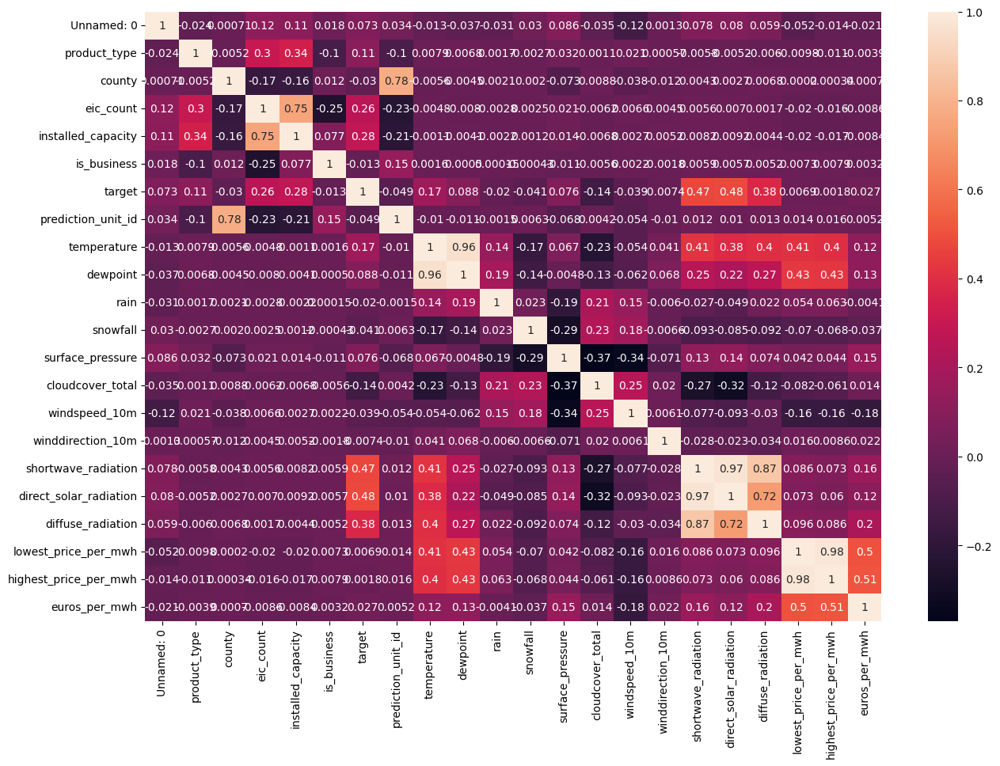

In [ ]:

correlation_matrix = data.corr()

fig, ax = plt.subplots(figsize=(15, 10))

sns.heatmap(correlation_matrix, annot=True, ax=ax)

plt.show()

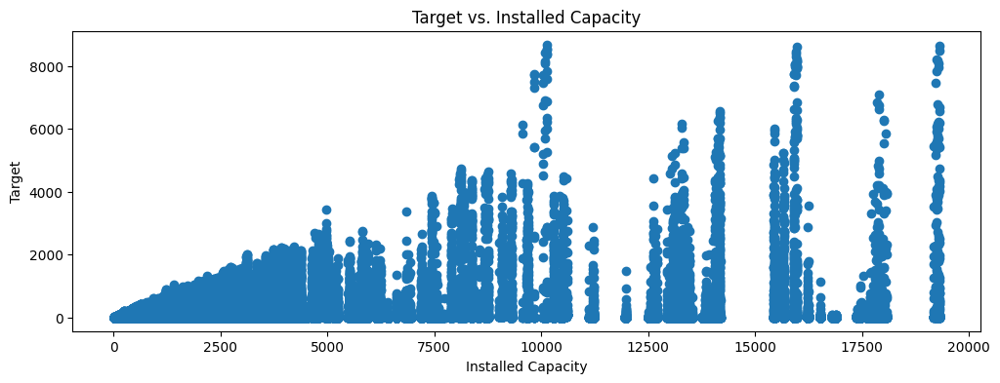

Correlation between installed capacity and target: 0.2790092088996326


In [ ]:
# prompt: I want to figure the target en fonction de installed capacity

# Create a scatter plot with installed capacity on the x-axis and target on the y-axis
plt.scatter(data['installed_capacity'], data['target'])

# Add a title and axis labels
plt.title('Target vs. Installed Capacity')
plt.xlabel('Installed Capacity')
plt.ylabel('Target')

# Show the plot
plt.show()

# Calculate the correlation coefficient between installed capacity and target
correlation = data['installed_capacity'].corr(data['target'])

# Print the correlation coefficient
print('Correlation between installed capacity and target:', correlation)

Feature creation ✅

In [ ]:
def create_features(df):
    # Assuming df's index is a DateTimeIndex
    df['hour'] = df.index.hour
    df['dayofweek'] = df.index.dayofweek  # Use 'dayofweek' instead of 'day_of_week'
    df['quarter'] = df.index.quarter
    df['month'] = df.index.month
    df['year'] = df.index.year
    df['dayofyear'] = df.index.dayofyear
    df['day'] = df.index.day # Use 'dayofyear' instead of 'day_of_year'
    return df


In [ ]:

data['datetime'] = pd.to_datetime(data['datetime'])
data = data.set_index('datetime')

In [ ]:
data= create_features(data)

In [ ]:
data.reset_index(inplace=True)
data.rename(columns={'index': 'datetime'}, inplace=True)

In [ ]:

def impute_target(group):
    # Make sure the group is sorted by date if it's not already
    group = group.sort_values('date')
    # Loop through each row in the group
    for i in range(1, len(group) - 1):
        # Check if the target value is NaN
        if np.isnan(group.iloc[i]['target']):
            # Calculate the mean of the target values at the previous and next row, if both are not NaN
            prev_val = group.iloc[i-1]['target']
            next_val = group.iloc[i+1]['target']
            if not np.isnan(prev_val) and not np.isnan(next_val):
                group.iloc[i, group.columns.get_loc('target')] = (prev_val + next_val) / 2
    return group

# Apply the impute function to each group
imputed_data = data.groupby(['product_type', 'county', 'is_business', 'date','prediction_unit_id']).apply(impute_target)

# Reset index if necessary
imputed_data = imputed_data.reset_index(drop=True)

# Now imputed_data should have the 'target' column imputed within each group
print(imputed_data)

<ipython-input-16-fe5e758c81f9>:16: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  imputed_data = data.groupby(['product_type', 'county', 'is_business', 'date','prediction_unit_id']).apply(impute_target)


         datetime  product_type  county  eic_count  installed_capacity  \
0      2021-09-01             1       0        108              952.89   
1      2021-09-01             2       0         17              166.40   
2      2021-09-01             3       0        688             7207.88   
3      2021-09-01             0       0          5              400.00   
4      2021-09-01             1       0         43             1411.00   
...           ...           ...     ...        ...                 ...   
445883 2023-05-29             1      15         51              415.60   
445884 2023-05-29             3      15        161             2035.75   
445885 2023-05-29             0      15         15              620.00   
445886 2023-05-29             1      15         20              624.50   
445887 2023-05-29             3      15         55             2188.20   

        is_business        date    target  prediction_unit_id  temperature  \
0                 0  2021-09-01  

In [ ]:
data=imputed_data

In [ ]:
data.rename(columns={'euros_per_mwh':'elect_prices'}, inplace=True)

In [ ]:
data = data.drop(columns=['date', 'prediction_unit_id'])

In [ ]:
data.to_csv('production.csv')

In [ ]:

train_size = int(len(data) * 0.8)

train_data = data[:train_size]
test_data = data[train_size:]

print(f"Train data size: {len(train_data)}")
print(f"Test data size: {len(test_data)}")

Train data size: 363185
Test data size: 90797


In [ ]:
train_data

,datetime,product_type,county,eic_count,installed_capacity,is_business,target,temperature,dewpoint,rain,...,lowest_price_per_mwh,highest_price_per_mwh,elect_prices,hour,dayofweek,quarter,month,year,dayofyear,day
0,2021-09-01 00:00:00,1,0,108,952.89,0,0.713,13.600000,10.600000,0.0,...,45.23,46.32,92.51,0,2,3,9,2021,244,1
1,2021-09-01 00:00:00,2,0,17,166.40,0,0.000,13.600000,10.600000,0.0,...,45.23,46.32,92.51,0,2,3,9,2021,244,1
2,2021-09-01 00:00:00,3,0,688,7207.88,0,2.904,13.600000,10.600000,0.0,...,45.23,46.32,92.51,0,2,3,9,2021,244,1
3,2021-09-01 00:00:00,0,0,5,400.00,1,0.000,13.600000,10.600000,0.0,...,45.23,46.32,92.51,0,2,3,9,2021,244,1
4,2021-09-01 00:00:00,1,0,43,1411.00,1,0.000,13.600000,10.600000,0.0,...,45.23,46.32,92.51,0,2,3,9,2021,244,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
363180,2023-01-23 04:00:00,1,13,14,138.70,0,0.000,-6.100000,-7.300000,0.0,...,67.00,71.91,108.55,4,0,1,1,2023,23,23
363181,2023-01-23 04:00:00,3,13,75,992.93,0,0.000,-6.100000,-7.300000,0.0,...,67.00,71.91,108.55,4,0,1,1,2023,23,23
363182,2023-01-23 04:00:00,1,13,10,268.00,1,0.000,-6.100000,-7.300000,0.0,...,67.00,71.91,108.55,4,0,1,1,2023,23,23
363183,2023-01-23 04:00:00,3,13,27,937.90,1,0.410,-6.100000,-7.300000,0.0,...,67.00,71.91,108.55,4,0,1,1,2023,23,23


In [ ]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 363185 entries, 0 to 363184
Data columns (total 28 columns):
 #   Column                  Non-Null Count   Dtype         
---  ------                  --------------   -----         
 0   datetime                363185 non-null  datetime64[ns]
 1   product_type            363185 non-null  int64         
 2   county                  363185 non-null  int64         
 3   eic_count               363185 non-null  int64         
 4   installed_capacity      363185 non-null  float64       
 5   is_business             363185 non-null  int64         
 6   target                  363185 non-null  float64       
 7   temperature             363185 non-null  float64       
 8   dewpoint                363185 non-null  float64       
 9   rain                    363185 non-null  float64       
 10  snowfall                363185 non-null  float64       
 11  surface_pressure        363185 non-null  float64       
 12  cloudcover_total        363185

In [ ]:
nan_counts = train_data.isna().sum()

# Add a new row with the column names and the number of NaN values
nan_counts = nan_counts.to_frame().T.rename(columns={0: 'count_nan'})

# Print the number of NaN values in each column
print(nan_counts)

   datetime  product_type  county  eic_count  installed_capacity  is_business  \
0         0             0       0          0                   0            0   

   target  temperature  dewpoint  rain  ...  lowest_price_per_mwh  \
0       0            0         0     0  ...                     0   

   highest_price_per_mwh  elect_prices  hour  dayofweek  quarter  month  year  \
0                      0             0     0          0        0      0     0   

   dayofyear  day  
0          0    0  

[1 rows x 28 columns]


calculer l'information mutuelle pour chaque feature Ⓜ


In [ ]:
train_data.drop(columns=['datetime'], inplace=True)
train_data

<ipython-input-22-84ccd4eb9bc9>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_data.drop(columns=['datetime'], inplace=True)


,product_type,county,eic_count,installed_capacity,is_business,target,temperature,dewpoint,rain,snowfall,...,lowest_price_per_mwh,highest_price_per_mwh,elect_prices,hour,dayofweek,quarter,month,year,dayofyear,day
0,1,0,108,952.89,0,0.713,13.600000,10.600000,0.0,0.0,...,45.23,46.32,92.51,0,2,3,9,2021,244,1
1,2,0,17,166.40,0,0.000,13.600000,10.600000,0.0,0.0,...,45.23,46.32,92.51,0,2,3,9,2021,244,1
2,3,0,688,7207.88,0,2.904,13.600000,10.600000,0.0,0.0,...,45.23,46.32,92.51,0,2,3,9,2021,244,1
3,0,0,5,400.00,1,0.000,13.600000,10.600000,0.0,0.0,...,45.23,46.32,92.51,0,2,3,9,2021,244,1
4,1,0,43,1411.00,1,0.000,13.600000,10.600000,0.0,0.0,...,45.23,46.32,92.51,0,2,3,9,2021,244,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
363180,1,13,14,138.70,0,0.000,-6.100000,-7.300000,0.0,0.0,...,67.00,71.91,108.55,4,0,1,1,2023,23,23
363181,3,13,75,992.93,0,0.000,-6.100000,-7.300000,0.0,0.0,...,67.00,71.91,108.55,4,0,1,1,2023,23,23
363182,1,13,10,268.00,1,0.000,-6.100000,-7.300000,0.0,0.0,...,67.00,71.91,108.55,4,0,1,1,2023,23,23
363183,3,13,27,937.90,1,0.410,-6.100000,-7.300000,0.0,0.0,...,67.00,71.91,108.55,4,0,1,1,2023,23,23


In [ ]:
X = train_data.drop('target', axis=1)  # X contient toutes les colonnes sauf la colonne 'label'
Y = train_data['target']

In [ ]:
features = X.columns.tolist()
print(features)

['product_type', 'county', 'eic_count', 'installed_capacity', 'is_business', 'temperature', 'dewpoint', 'rain', 'snowfall', 'surface_pressure', 'cloudcover_total', 'windspeed_10m', 'winddirection_10m', 'shortwave_radiation', 'direct_solar_radiation', 'diffuse_radiation', 'lowest_price_per_mwh', 'highest_price_per_mwh', 'elect_prices', 'hour', 'dayofweek', 'quarter', 'month', 'year', 'dayofyear', 'day']


In [ ]:
from sklearn.feature_selection import mutual_info_regression
import pandas as pd

mi_scores = mutual_info_regression(X, Y)


mi_scores_df = pd.DataFrame(mi_scores, index=X.columns, columns=['MI Score'])

mi_scores_sorted = mi_scores_df.sort_values(by='MI Score', ascending=False)


print(mi_scores_sorted)

                        MI Score
installed_capacity      0.521748
shortwave_radiation     0.508193
diffuse_radiation       0.487417
direct_solar_radiation  0.460983
eic_count               0.293197
elect_prices            0.287343
hour                    0.265709
dayofyear               0.137557
temperature             0.113188
highest_price_per_mwh   0.110476
lowest_price_per_mwh    0.109432
month                   0.109303
county                  0.085070
dewpoint                0.075851
quarter                 0.075005
product_type            0.073219
cloudcover_total        0.048466
surface_pressure        0.040510
is_business             0.027237
year                    0.026738
windspeed_10m           0.025219
winddirection_10m       0.024575
snowfall                0.022235
rain                    0.008860
day                     0.003535
dayofweek               0.002882


In [ ]:

from sklearn.ensemble import RandomForestRegressor

# Create a Random Forest Regressor model
model = RandomForestRegressor()

# Fit the model on the training data
model.fit(train_data.drop('target', axis=1), train_data['target'])

# Calculate feature importances
importances = model.feature_importances_

# Create a dataframe of feature importances
feature_importances = pd.DataFrame({
    'feature': train_data.drop('target', axis=1).columns,
    'importance': importances
})

# Sort the dataframe by importance
feature_importances = feature_importances.sort_values('importance', ascending=False)

# Print the feature importances
print(feature_importances)

                   feature  importance
3       installed_capacity    0.518219
13     shortwave_radiation    0.331167
2                eic_count    0.042827
20               dayofweek    0.013700
19                    hour    0.013502
24               dayofyear    0.011196
14  direct_solar_radiation    0.008410
9         surface_pressure    0.007789
18            elect_prices    0.006321
10        cloudcover_total    0.005768
16    lowest_price_per_mwh    0.005188
11           windspeed_10m    0.005106
15       diffuse_radiation    0.004677
12       winddirection_10m    0.004222
25                     day    0.003933
5              temperature    0.003780
17   highest_price_per_mwh    0.003659
6                 dewpoint    0.003405
7                     rain    0.002012
1                   county    0.001627
4              is_business    0.001167
0             product_type    0.001066
8                 snowfall    0.000567
22                   month    0.000392
21                 quarte

In [ ]:
!pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 538.2/538.2 kB 8.6 MB/s eta 0:00:00


In [ ]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 2.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=8b1ebd3ff468ab2924bf166452770b17fb2bf43e43c7f5db4763b338c777ef3c
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
from sklearn.model_selection import train_test_split
from xgboost import XGBRegressor
from xgboost import plot_importance, plot_tree
from sklearn.metrics import mean_squared_error

# Additional libraries for explainability:
from shap import Explainer
from lime import lime_tabular
import shap
features = train_data.drop("target", axis=1)
target = train_data["target"]



model = XGBRegressor(n_estimators=100, max_depth=5, learning_rate=0.1)

# Train the model
model.fit(X,Y)


XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=5, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=100, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [ ]:
test_data=test_data.drop(columns=['datetime'])

In [ ]:
X_test=test_data.drop('target', axis=1)  # X contient toutes les colonnes sauf la colonne 'label'
y_test = test_data['target']

In [ ]:

# Evaluate the model (e.g., mean squared error)
y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print(f"Mean squared error: {mse}")


Mean squared error: 22610.63475969061


<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

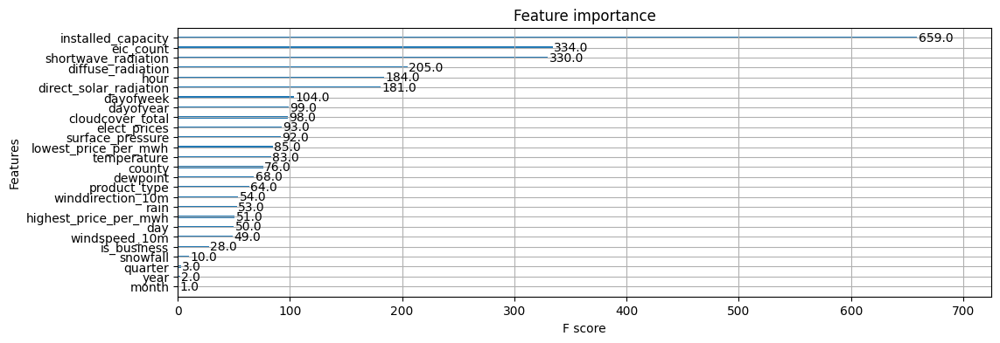

In [ ]:

plot_importance(model)

In [ ]:
import xgboost as xgb

# Create a DMatrix from the training data
dtrain = xgb.DMatrix(train_data.drop('target', axis=1), label=train_data['target'])

# Specify parameters for GPU use
params = {'tree_method': 'gpu_hist', 'objective': 'reg:squarederror'}

# Train the model
model = xgb.train(params, dtrain)

# Calculate feature importances
importances = model.get_score(importance_type='weight')

# Convert importances into a sorted dataframe
feature_importances = pd.DataFrame(list(importances.items()), columns=['feature', 'importance']).sort_values('importance', ascending=False)

# Print the feature importances
print(feature_importances)


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:160: UserWarning: [08:48:11] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)


                   feature  importance
3       installed_capacity       113.0
2                eic_count        97.0
13     shortwave_radiation        64.0
19                    hour        59.0
21               dayofyear        36.0
20               dayofweek        32.0
10        cloudcover_total        28.0
9         surface_pressure        23.0
14  direct_solar_radiation        22.0
18            elect_prices        19.0
0             product_type        15.0
11           windspeed_10m        13.0
1                   county        13.0
5              temperature        13.0
7                     rain        12.0
6                 dewpoint        11.0
15       diffuse_radiation        10.0
17   highest_price_per_mwh        10.0
12       winddirection_10m         9.0
16    lowest_price_per_mwh         9.0
22                     day         9.0
8                 snowfall         3.0
4              is_business         3.0


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:160: UserWarning: [08:48:12] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)


In [ ]:
df = pd.DataFrame({'actual': y_test, 'predicted': y_pred})

# Calculate the difference between the actual and predicted values
df['difference'] = df['actual'] - df['predicted']

# Print the dataframe
print(df)


          actual   predicted  difference
363185     0.004    5.400062   -5.396062
363186     0.000    1.577102   -1.577102
363187    20.210    5.664692   14.545308
363188     0.140    0.689508   -0.549508
363189     0.022    1.414906   -1.392906
...          ...         ...         ...
453977   224.109  214.852768    9.256232
453978  1072.256  949.845337  122.410663
453979   170.411  246.890884  -76.479884
453980   329.412  253.243622   76.168378
453981   733.917  724.269104    9.647896

[90797 rows x 3 columns]


In [ ]:
final_df = pd.concat([X_test, df], axis=1)

In [ ]:
!pip install python-dateutil

In [ ]:
final_df['year'] = final_df['year'].astype('int64')
final_df['month'] = final_df['month'].astype('int64')
final_df['day'] = final_df['day'].astype('int64')
final_df['hour'] = final_df['hour'].astype('int64')

In [ ]:
final_df['datetime'] = pd.to_datetime(final_df[['year', 'month', 'day', 'hour']])

In [ ]:
final_df

,product_type,county,eic_count,installed_capacity,is_business,temperature,dewpoint,rain,snowfall,surface_pressure,...,dayofweek,quarter,month,year,dayofyear,day,actual,predicted,difference,datetime
363185,3,14,200,2499.05,0,-7.033333,-7.633333,0.00,0.0,1032.166667,...,0,1,1,2023,23,23,0.004,5.400062,-5.396062,2023-01-23 04:00:00
363186,1,14,17,387.60,1,-7.033333,-7.633333,0.00,0.0,1032.166667,...,0,1,1,2023,23,23,0.000,1.577102,-1.577102,2023-01-23 04:00:00
363187,3,14,89,4382.30,1,-7.033333,-7.633333,0.00,0.0,1032.166667,...,0,1,1,2023,23,23,20.210,5.664692,14.545308,2023-01-23 04:00:00
363188,1,15,44,304.40,0,-5.320000,-6.840000,0.00,0.0,1024.780000,...,0,1,1,2023,23,23,0.140,0.689508,-0.549508,2023-01-23 04:00:00
363189,3,15,118,1492.89,0,-5.320000,-6.840000,0.00,0.0,1024.780000,...,0,1,1,2023,23,23,0.022,1.414906,-1.392906,2023-01-23 04:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
453977,1,15,51,415.60,0,15.680000,7.180000,0.04,0.0,1004.120000,...,0,2,5,2023,149,29,224.109,214.852768,9.256232,2023-05-29 10:00:00
453978,3,15,161,2035.75,0,15.680000,7.180000,0.04,0.0,1004.120000,...,0,2,5,2023,149,29,1072.256,949.845337,122.410663,2023-05-29 10:00:00
453979,0,15,15,620.00,1,15.680000,7.180000,0.04,0.0,1004.120000,...,0,2,5,2023,149,29,170.411,246.890884,-76.479884,2023-05-29 10:00:00
453980,1,15,20,624.50,1,15.680000,7.180000,0.04,0.0,1004.120000,...,0,2,5,2023,149,29,329.412,253.243622,76.168378,2023-05-29 10:00:00


In [ ]:

import matplotlib.pyplot as plt

# Plot the actual and predicted values against the datetime index
plt.figure(figsize=(16, 6))
plt.plot(final_df['datetime'], final_df['actual'], label='Actual')
plt.plot(final_df['datetime'], final_df['predicted'], label='Predicted')

# Add a legend and title
plt.legend()
plt.title('Actual vs. Predicted Values over Time')

# Show the plot
plt.show()

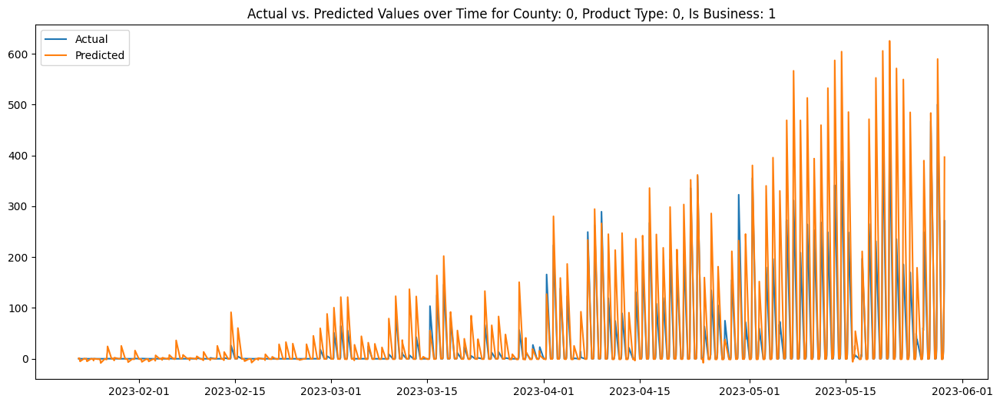

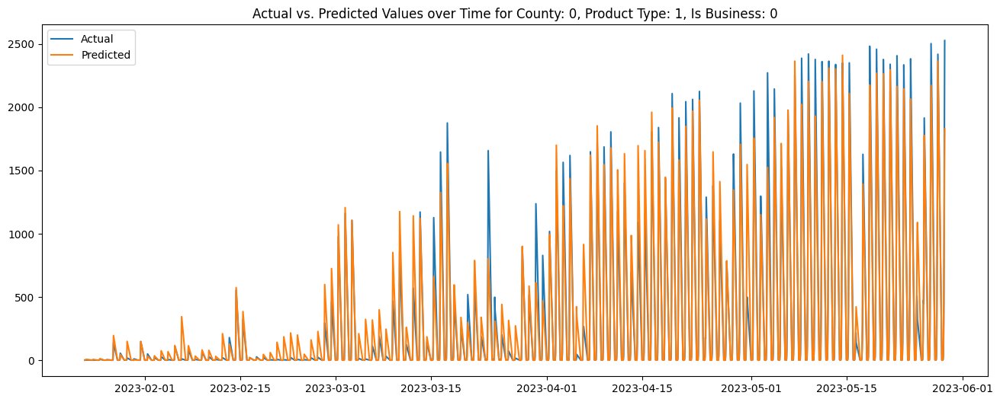

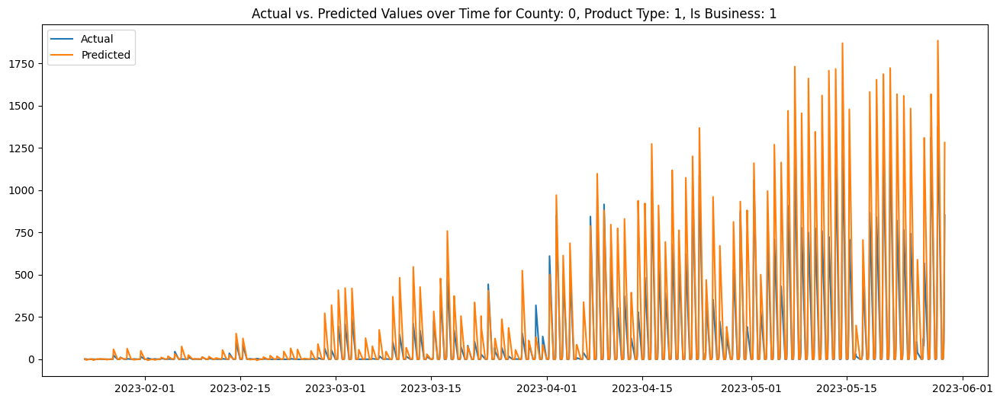

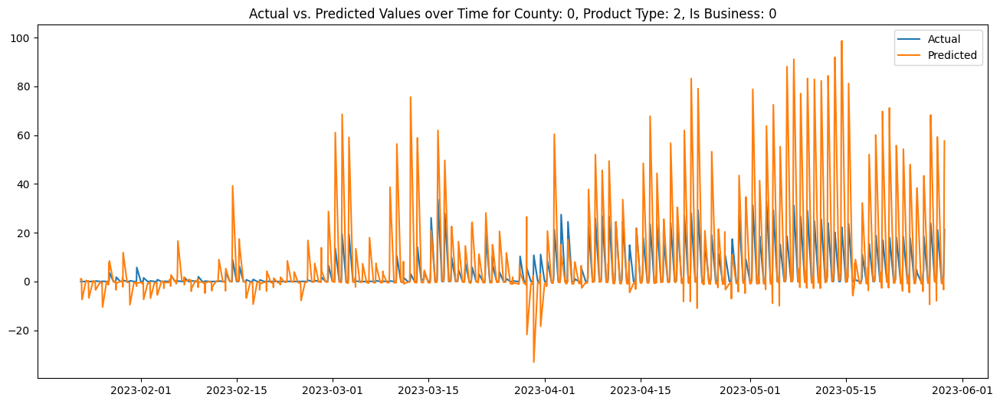

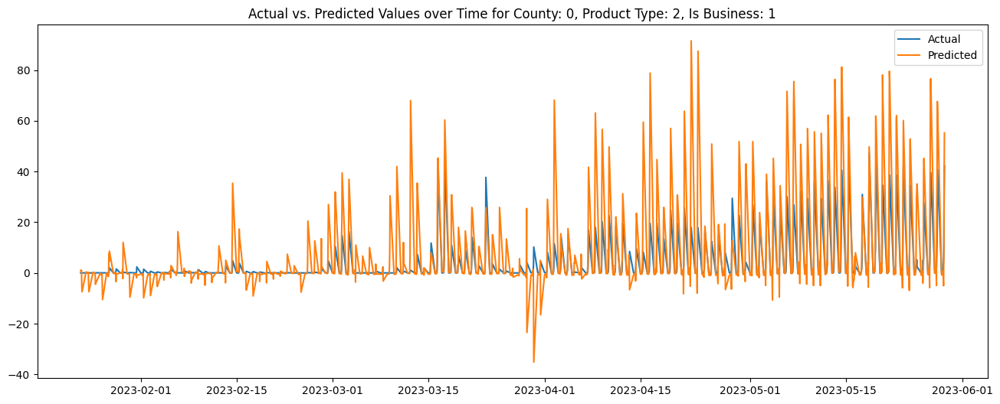

...

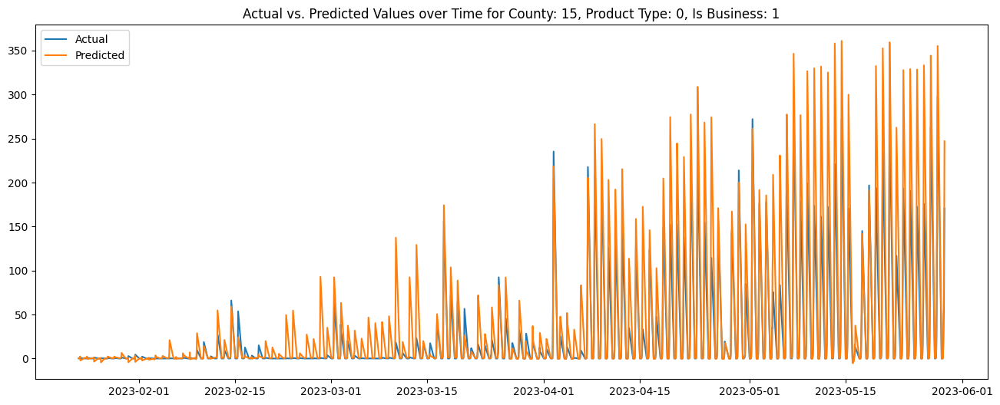

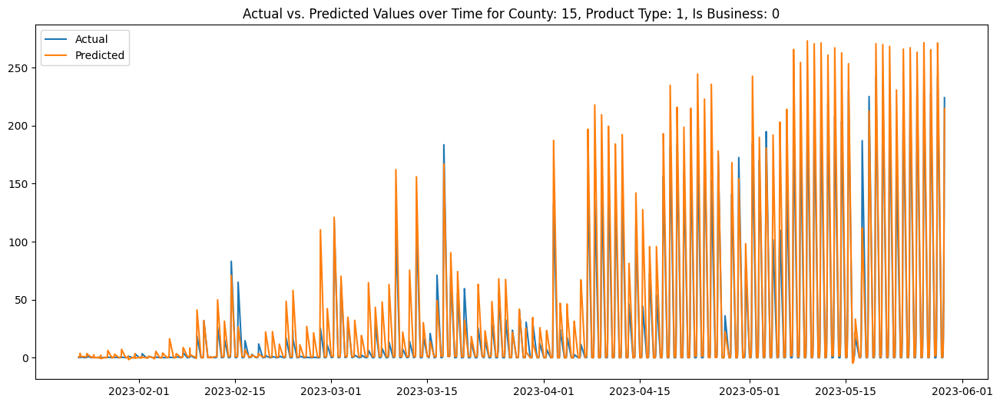

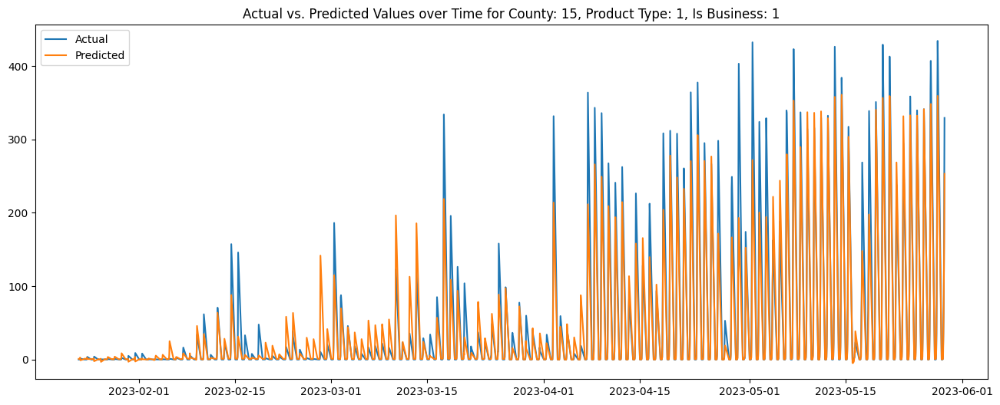

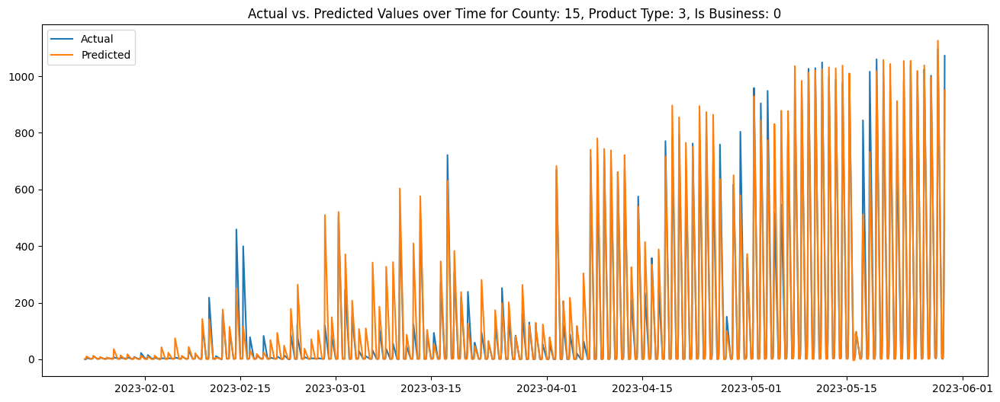

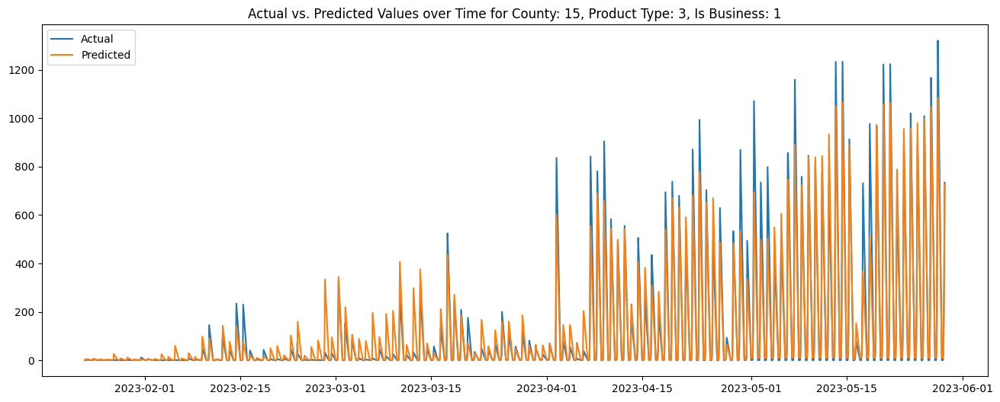

In [ ]:
import matplotlib.pyplot as plt

# Group the DataFrame by 'county', 'product_type', and 'is_business'
grouped = final_df.groupby(['county', 'product_type', 'is_business'])

# Iterate over each group
for name, group in grouped:
    # name is a tuple containing the values of ('county', 'product_type', 'is_business') for the current group
    # group is the subset of the DataFrame corresponding to the current group

    plt.figure(figsize=(16, 6))

    # Sort the group by datetime to ensure correct plotting
    group = group.sort_values('datetime')

    # Plot the actual and predicted values against the datetime index
    plt.plot(group['datetime'], group['actual'], label='Actual')
    plt.plot(group['datetime'], group['predicted'], label='Predicted')

    # Add a legend and title
    plt.legend()

    # Create a title that includes the current group's information
    plt.title(f"Actual vs. Predicted Values over Time for County: {name[0]}, Product Type: {name[1]}, Is Business: {name[2]}")

    # Show the plot
    plt.show()


etude stationnaire ⏰

1/ plot for each categories of clinet the target by each timeµ

In [ ]:
data1=pd.read_csv('production.csv')
data1.drop(['Unnamed: 0'],axis=1,inplace=True)
data1.head()

,datetime,product_type,county,eic_count,installed_capacity,is_business,date,target,prediction_unit_id,temperature,...,lowest_price_per_mwh,highest_price_per_mwh,elect_prices,hour,dayofweek,quarter,month,year,dayofyear,day
0,2021-09-01 00:00:00,1,0,108,952.89,0,2021-09-01,0.713,0,13.6,...,45.23,46.32,92.51,0,2,3,9,2021,244,1
1,2021-09-01 00:00:00,2,0,17,166.40,0,2021-09-01,0.000,1,13.6,...,45.23,46.32,92.51,0,2,3,9,2021,244,1
2,2021-09-01 00:00:00,3,0,688,7207.88,0,2021-09-01,2.904,2,13.6,...,45.23,46.32,92.51,0,2,3,9,2021,244,1
3,2021-09-01 00:00:00,0,0,5,400.00,1,2021-09-01,0.000,3,13.6,...,45.23,46.32,92.51,0,2,3,9,2021,244,1
4,2021-09-01 00:00:00,1,0,43,1411.00,1,2021-09-01,0.000,4,13.6,...,45.23,46.32,92.51,0,2,3,9,2021,244,1


In [ ]:
# prompt: diviser data1 to train and test

train_size = int(len(data1) * 0.8)

train_data1 = data1[:train_size]
test_data1 = data1[train_size:]

print(f"Train data size: {len(train_data1)}")
print(f"Test data size: {len(test_data1)}")


Train data size: 363185
Test data size: 90797


In [ ]:
!pip install statsmodels
from IPython.display import display

import numpy as np
import pandas as pd
pd.set_option('display.max_rows', 15)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

import matplotlib.pyplot as plt
from datetime import datetime
from datetime import timedelta
from pandas.plotting import register_matplotlib_converters

register_matplotlib_converters()

from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from time import time
import seaborn as sns
sns.set(style="whitegrid")

import warnings
warnings.filterwarnings('ignore')

RANDOM_SEED = np.random.seed(0)

<ipython-input-48-b3a23d5051bd>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_data1['datetime'] = pd.to_datetime(train_data1['datetime'])


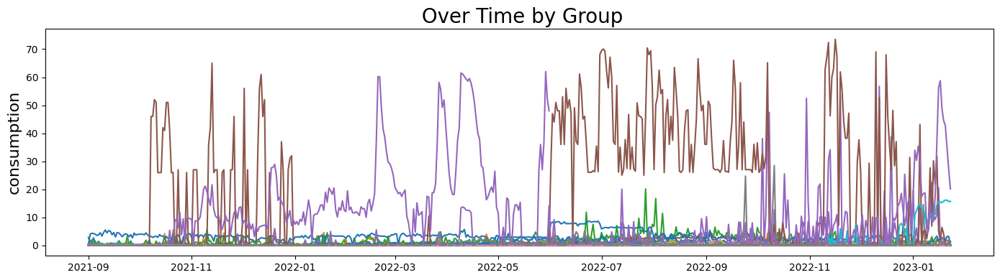

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Ensure the 'datetime' column is in datetime format
train_data1['datetime'] = pd.to_datetime(train_data1['datetime'])
start_date = train_data1['datetime'].min()
end_date = train_data1['datetime'].max()
# Group the data by 'is_business', 'county', and 'product_type'
groups = train_data1.groupby(['is_business', 'county', 'product_type'])

# Plotting
plt.figure(figsize=(14, 4))

for (is_business, county, product_type), group in groups:
    # Set the index to 'datetime' for this group
    group = group.set_index('datetime')

    # Infer the frequency and reindex (if necessary)
    group = group.asfreq(pd.infer_freq(group.index))

    # Filter by start and end date
    lim_group = group[start_date:end_date]

    # Plotting the 'target' for this group
    plt.plot(lim_group.index, lim_group['target'], label=f'{is_business}, {county}, {product_type}')

plt.title(' Over Time by Group', fontsize=20)
plt.ylabel('consumption', fontsize=16)
#plt.legend(title='Group: is_business, County, Product Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

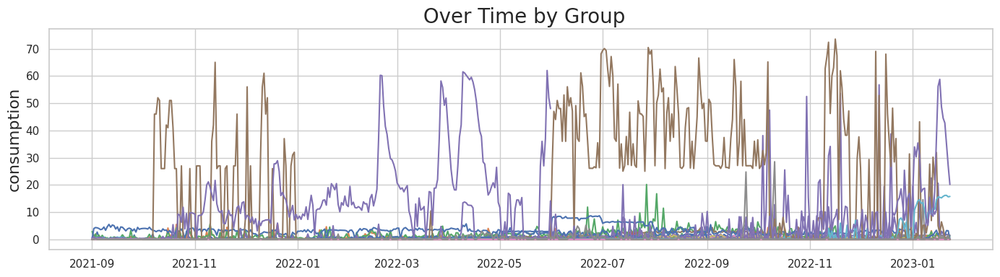

ValueError: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None

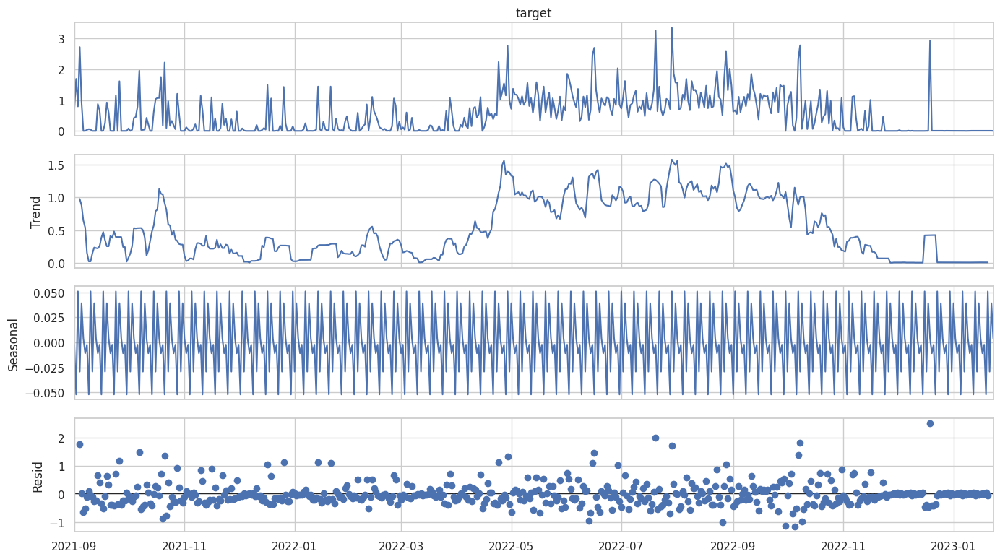

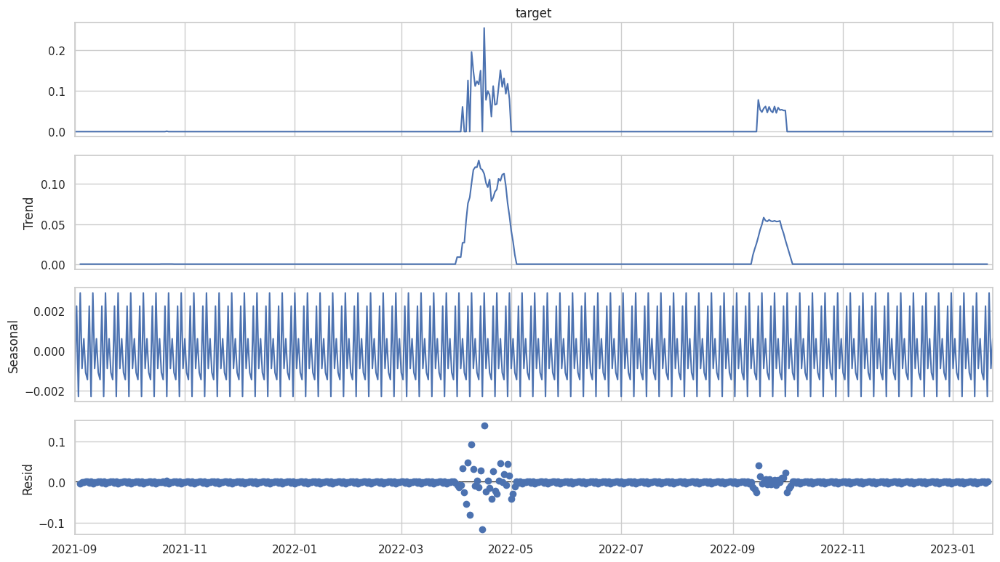

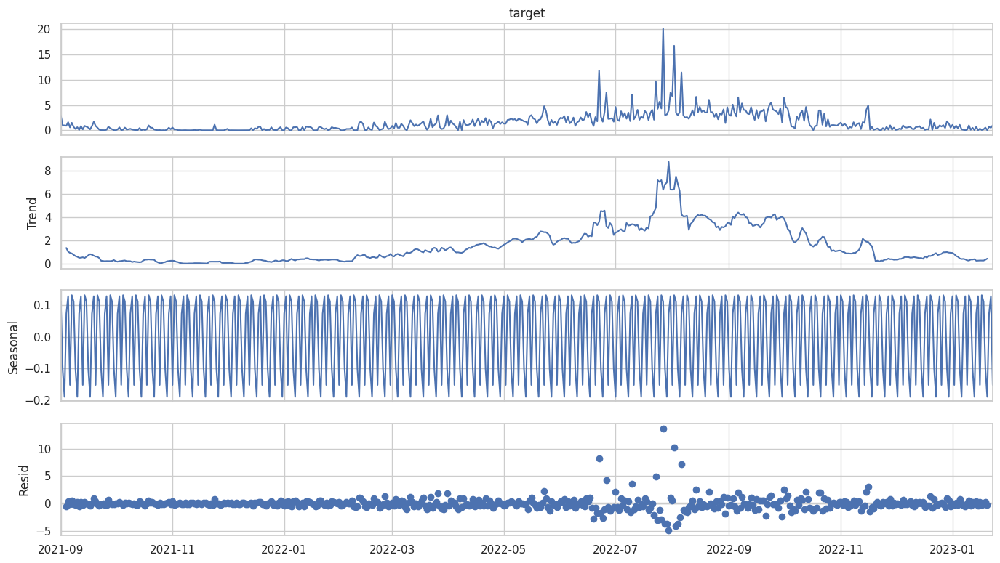

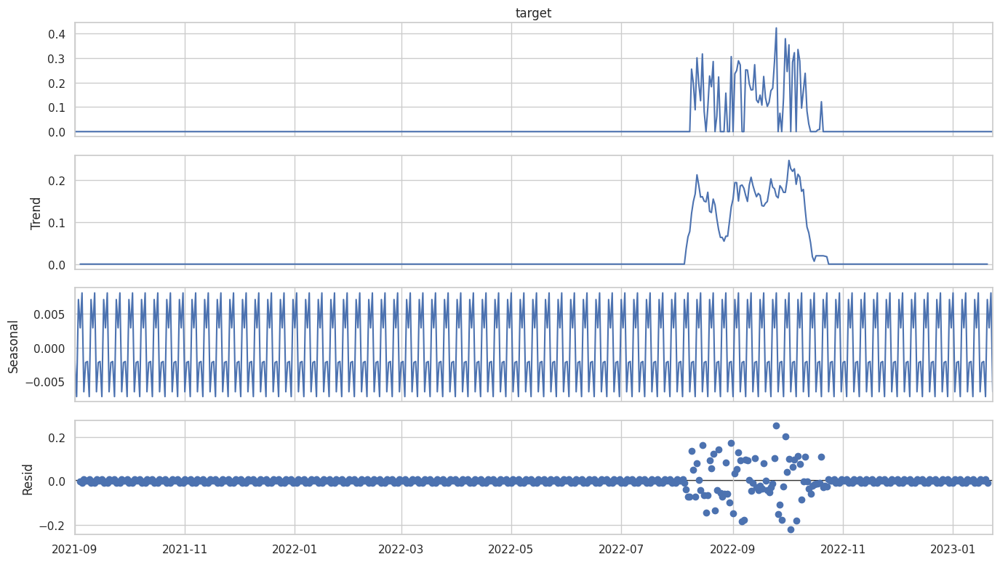

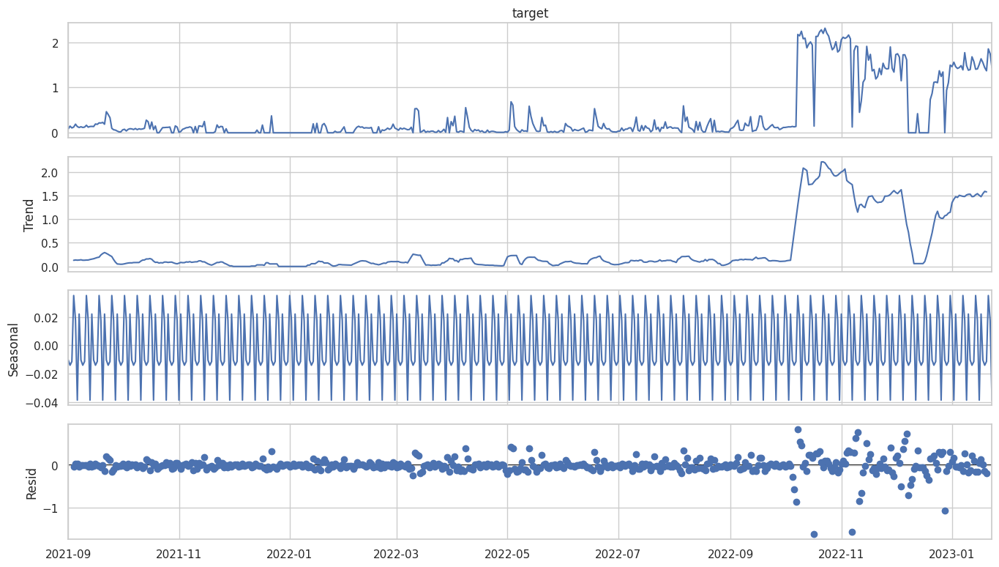

...

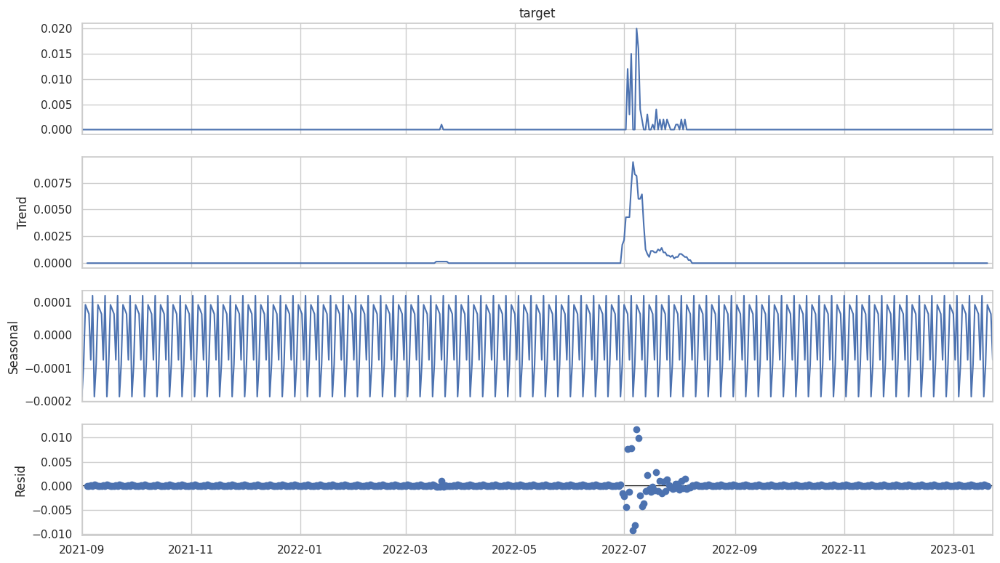

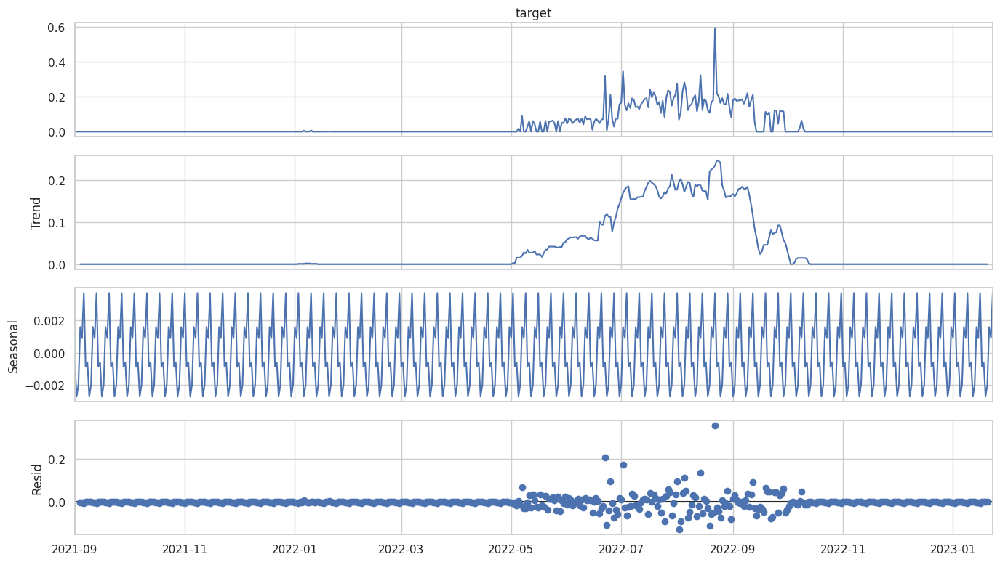

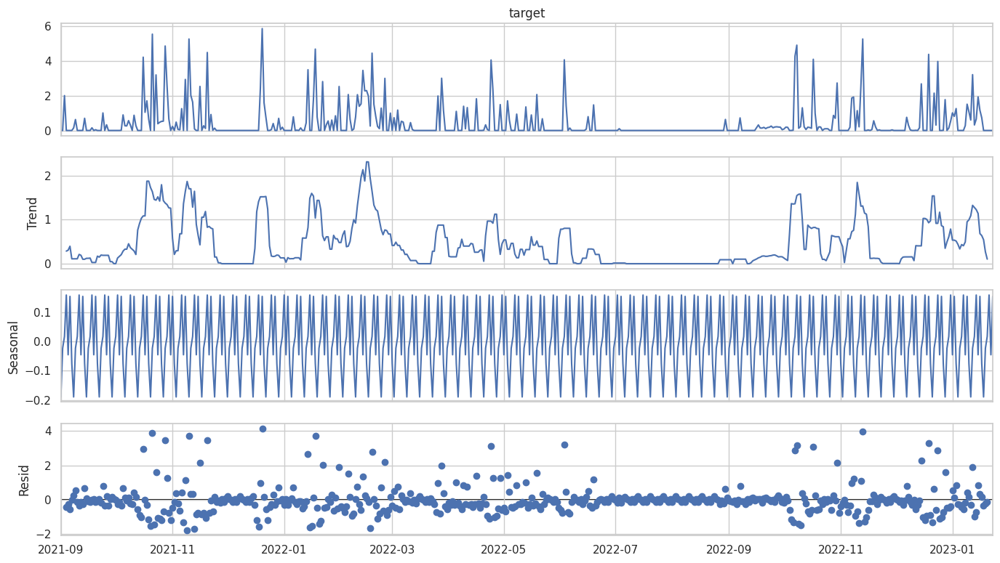

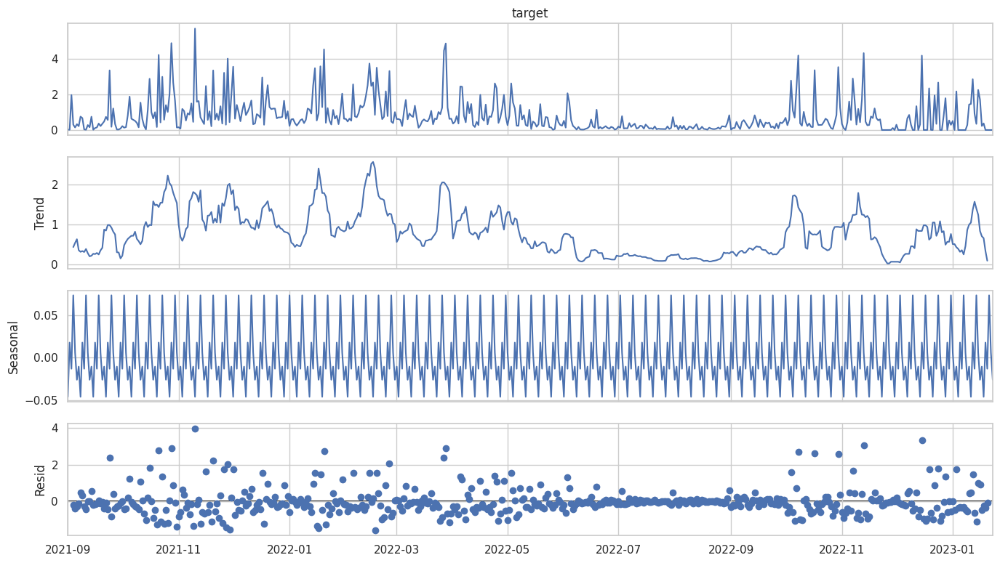

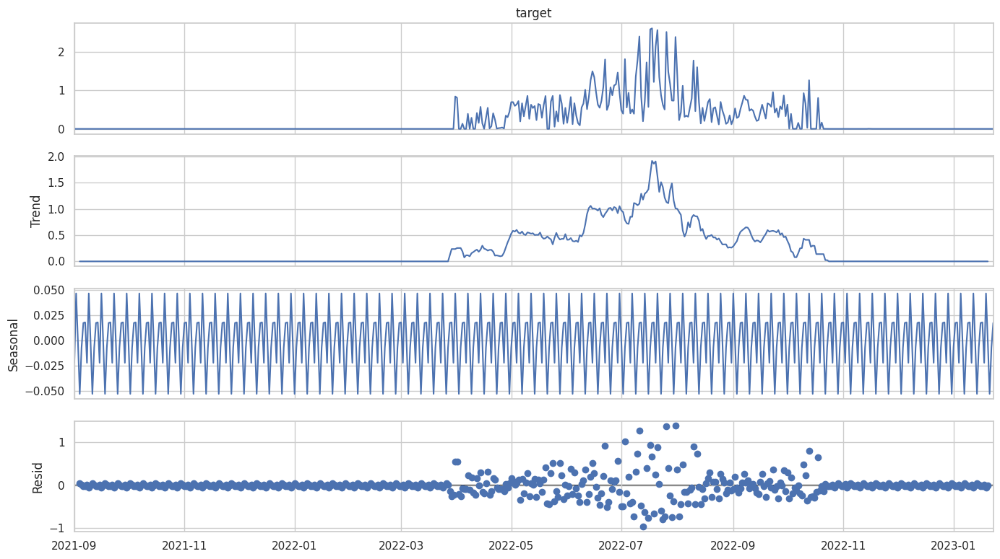

In [ ]:
import pandas as pd

# Convert 'datetime' column to datetime format
train_data1['datetime'] = pd.to_datetime(train_data1['datetime'])

# Drop rows with missing values in 'target'
train_data1 = train_data1.dropna(subset=['target'])

# Group the data by 'is_business', 'county', and 'product_type'
groups = train_data1.groupby(['is_business', 'county', 'product_type'])

# Plotting
plt.figure(figsize=(14, 4))

for (is_business, county, product_type), group in groups:
    # Set the index to 'datetime' for this group
    group = group.set_index('datetime')

    # Infer the frequency and reindex (if necessary)
    group = group.asfreq(pd.infer_freq(group.index))

    # Filter by start and end date
    lim_group = group[start_date:end_date]

    # Plotting the 'target' for this group
    plt.plot(lim_group.index, lim_group['target'], label=f'{is_business}, {county}, {product_type}')

plt.title(' Over Time by Group', fontsize=20)
plt.ylabel('consumption', fontsize=16)
#plt.legend(title='Group: is_business, County, Product Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

for (is_business, county, product_type), group in groups:
    # Set the index to 'datetime' for this group
    group = group.set_index('datetime')

    # Infer the frequency and reindex (if necessary)
    group = group.asfreq(pd.infer_freq(group.index))

    # Filter by start and end date
    lim_group = group[start_date:end_date]
    plt.rc('figure', figsize=(14, 8))
    plt.rc('font', size=15)

    result = seasonal_decompose(lim_group['target'].dropna(), model='additive')
    fig = result.plot()

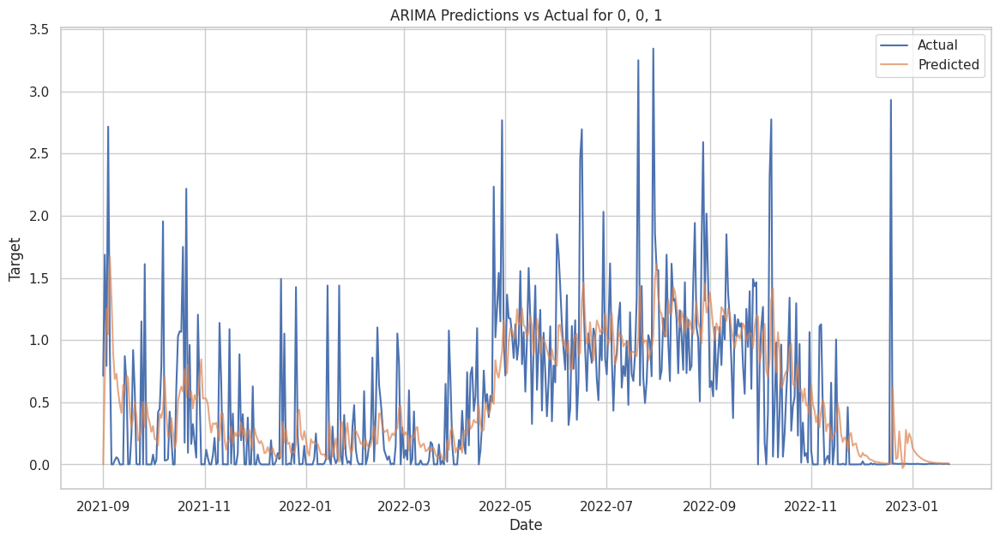

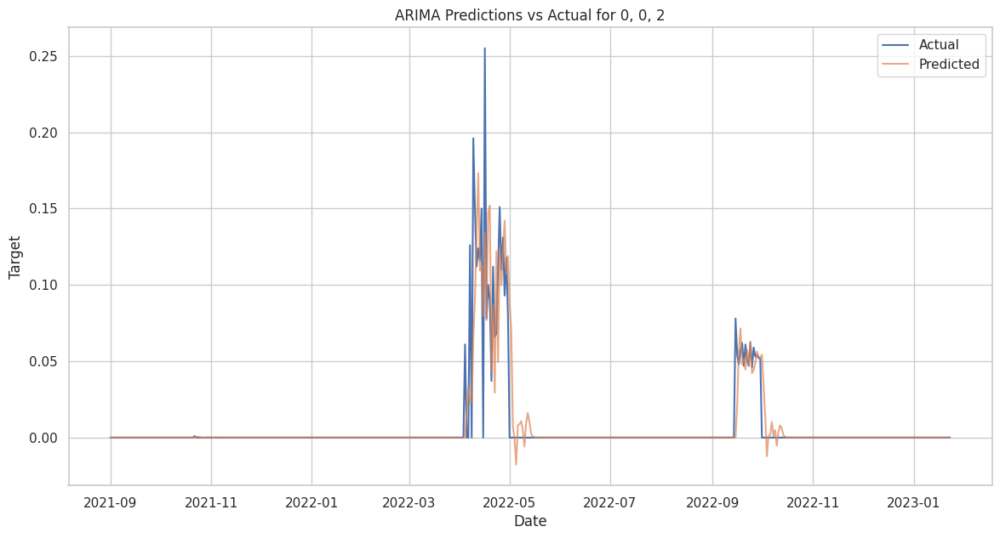

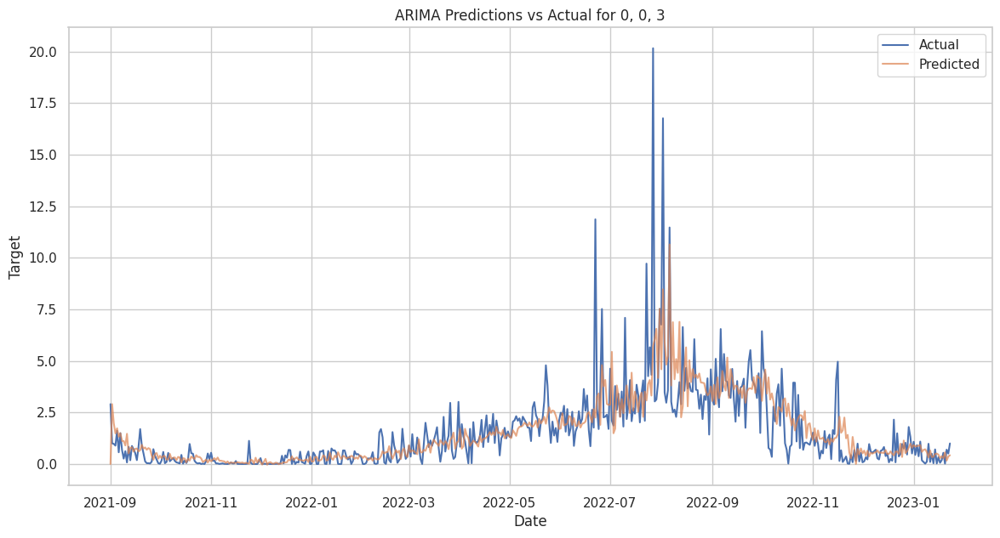

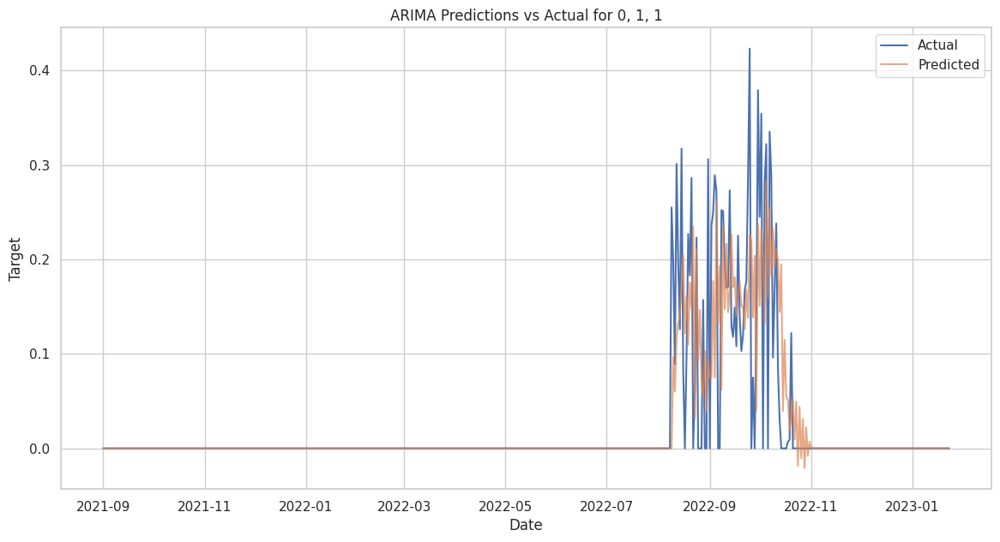

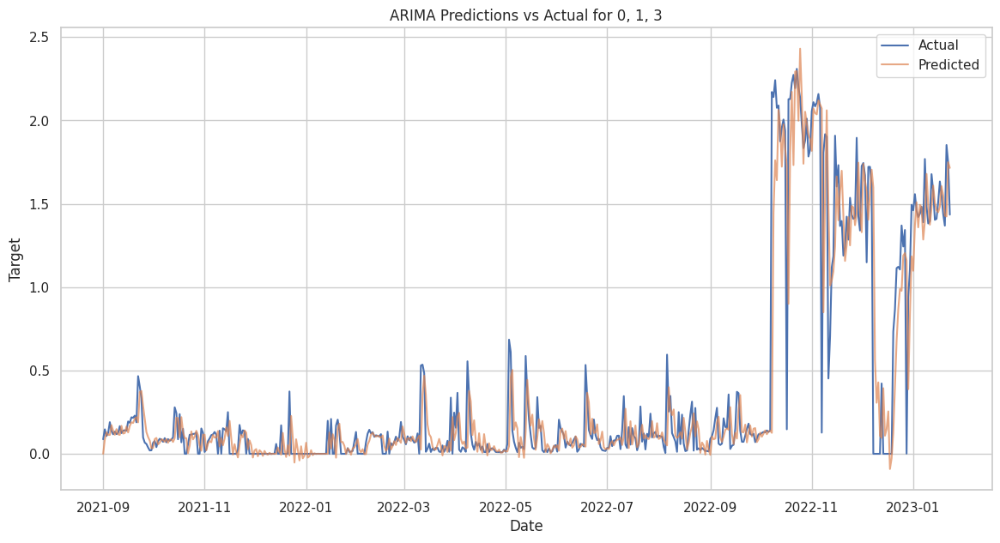

...

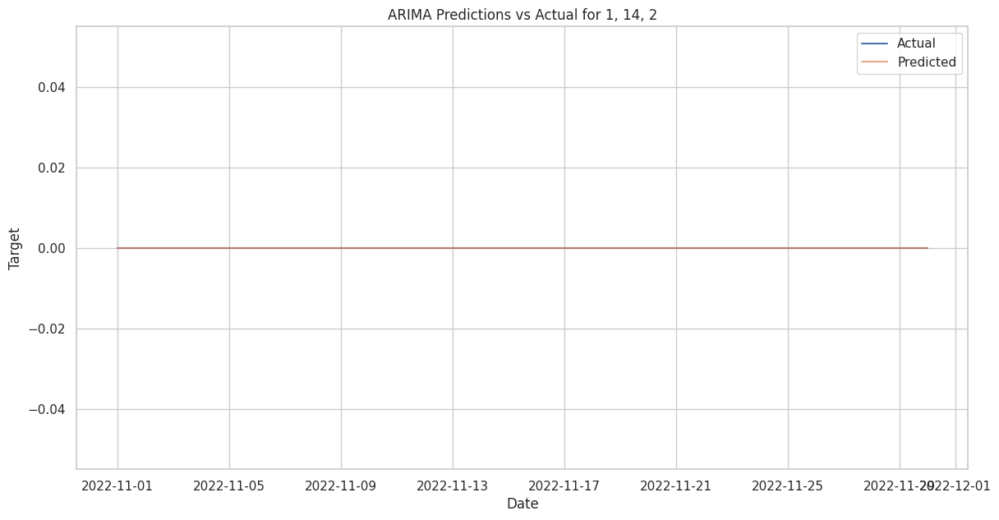

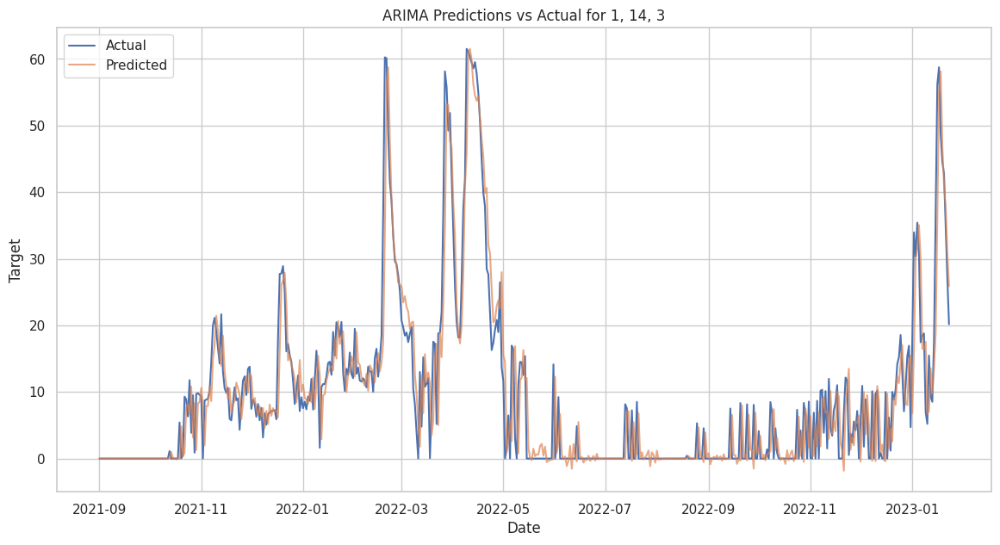

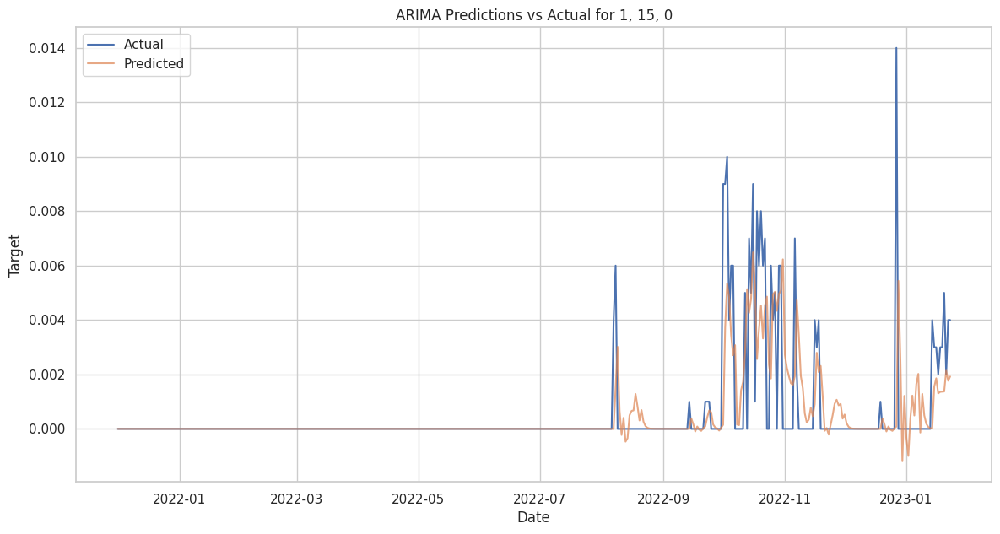

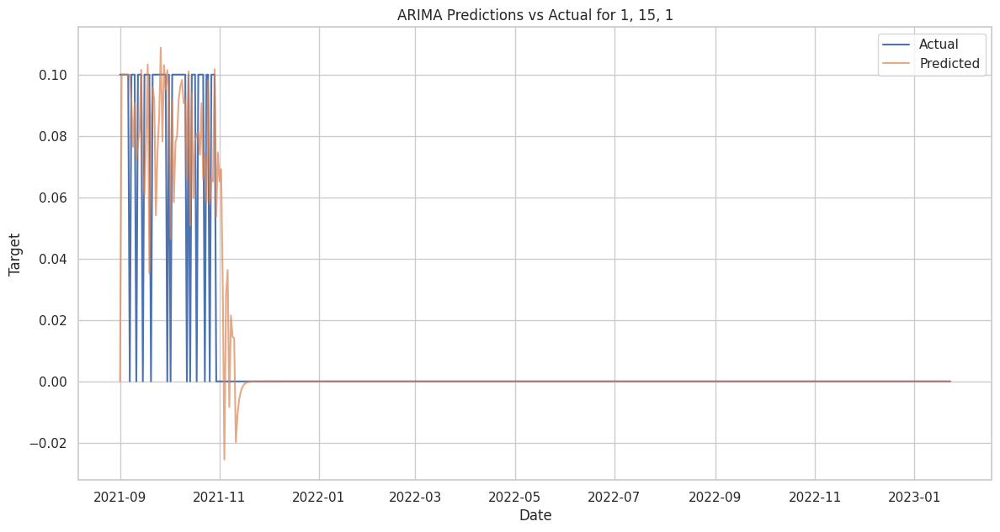

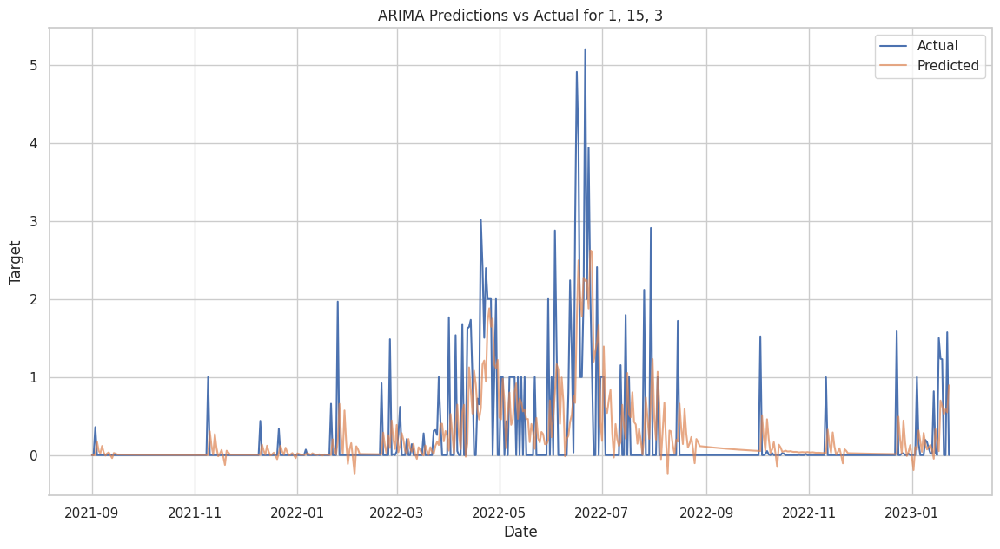

In [ ]:
from statsmodels.tsa.arima.model import ARIMA

# Assuming 'groups' is your DataFrame grouped by 'is_business', 'county', and 'product_type'
for (is_business, county, product_type), group in groups:
    # Ensure 'datetime' is the index and reindex if necessary
    group = group.set_index('datetime')
    group = group.asfreq(pd.infer_freq(group.index))

    # Filter by start and end date
    lim_group = group[start_date:end_date]

    # Check if the group has data to model
    if not lim_group.empty and 'target' in lim_group.columns:
        # Fit ARIMA model
        # Adjust the order (p,d,q) as per your analysis
        model = ARIMA(lim_group['target'], order=(12,1,1))
        model_fit = model.fit()

        # Generate predictions
        predictions = model_fit.predict(start=lim_group.index[0], end=lim_group.index[-1])

        # Plot actual vs predicted values
        plt.figure(figsize=(14, 7))
        plt.plot(lim_group.index, lim_group['target'], label='Actual')
        plt.plot(predictions.index, predictions, label='Predicted', alpha=0.7)
        plt.title(f'ARIMA Predictions vs Actual for {is_business}, {county}, {product_type}')
        plt.xlabel('Date')
        plt.ylabel('Target')
        plt.legend()
        plt.show()


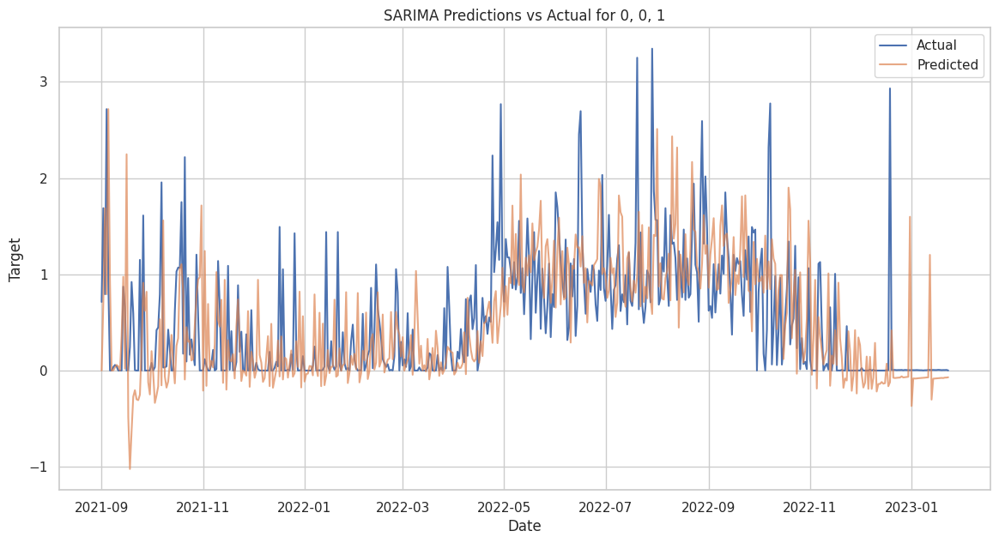

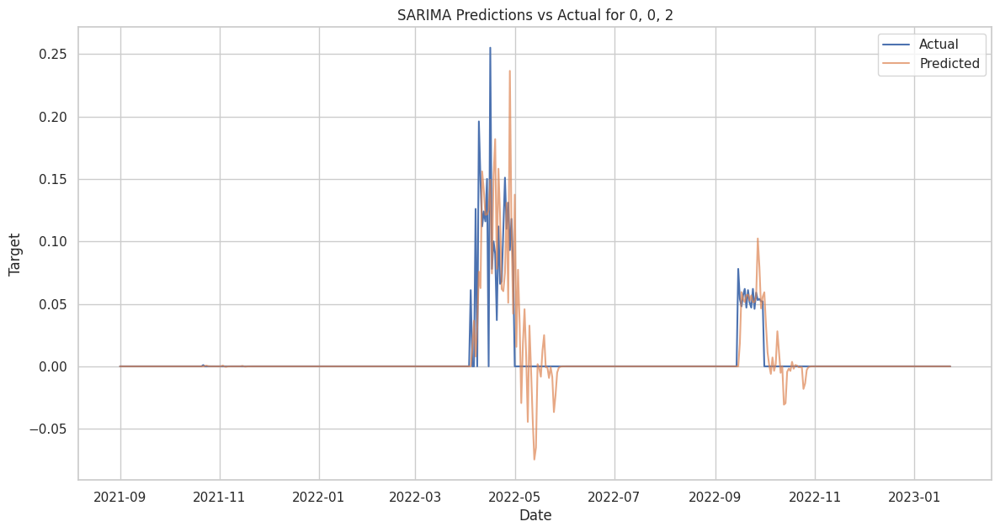

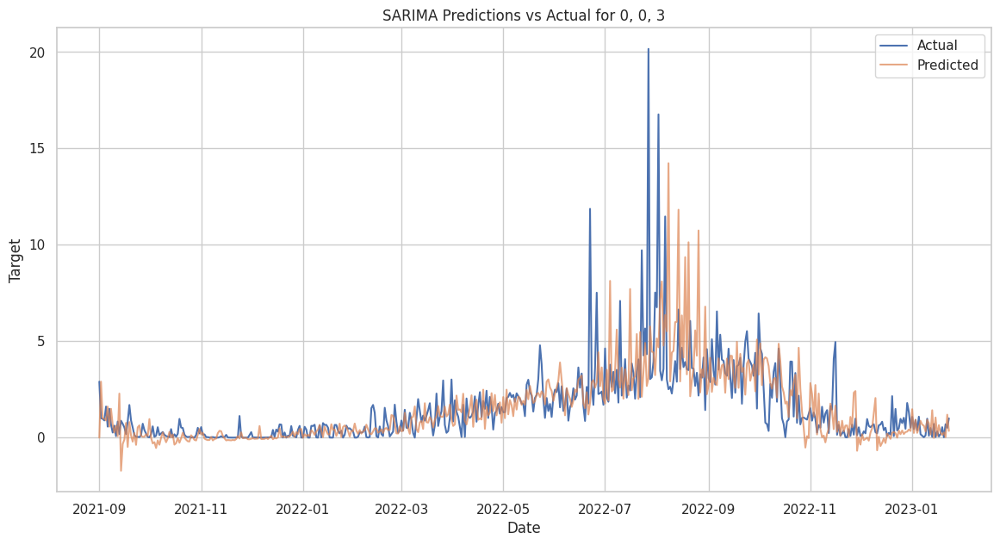

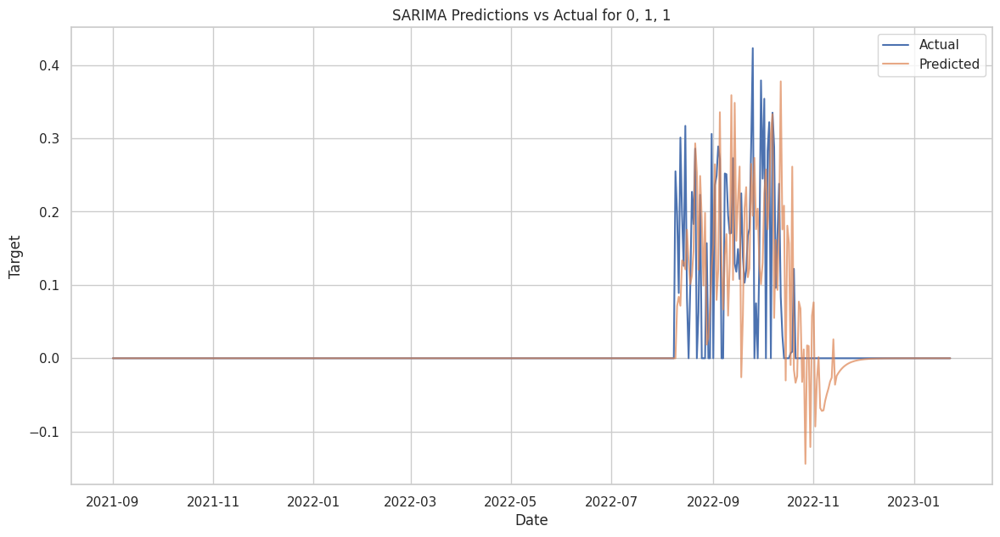

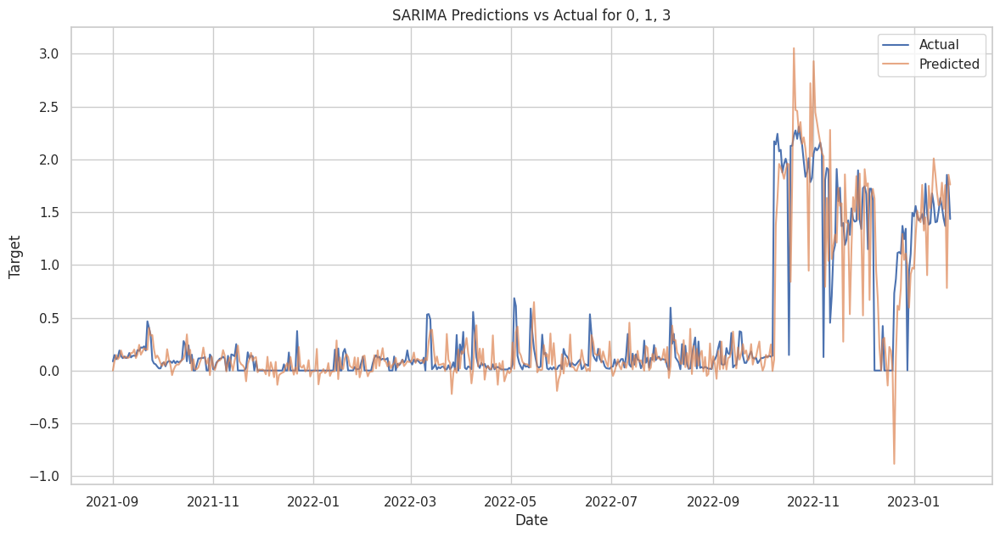

...

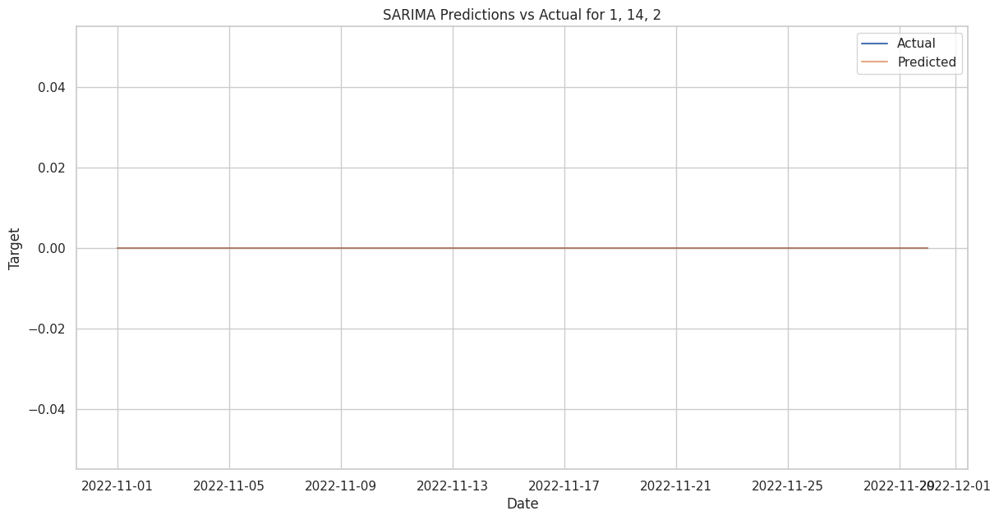

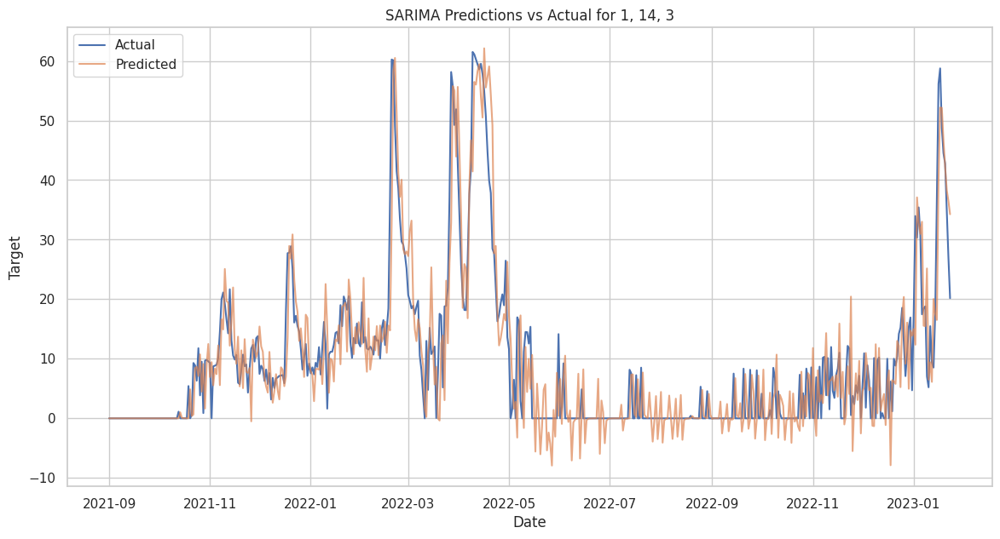

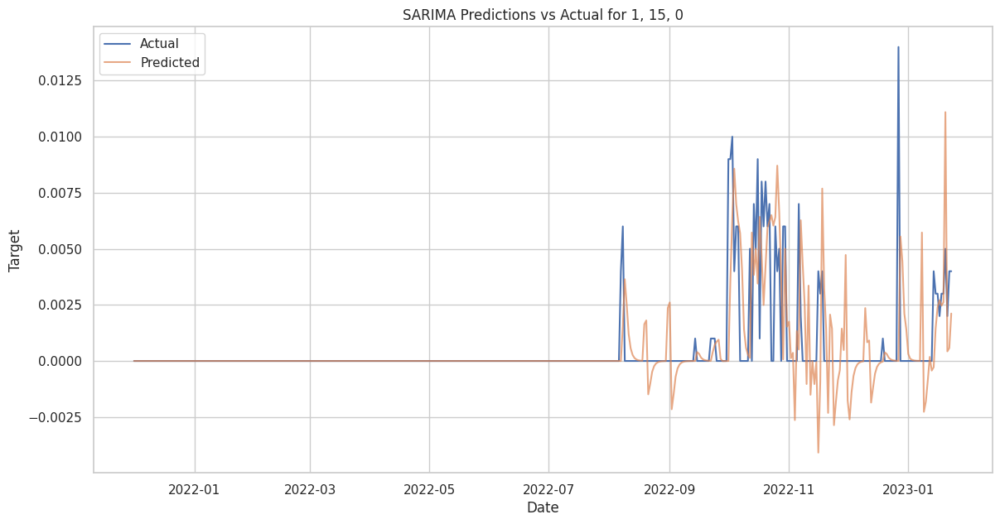

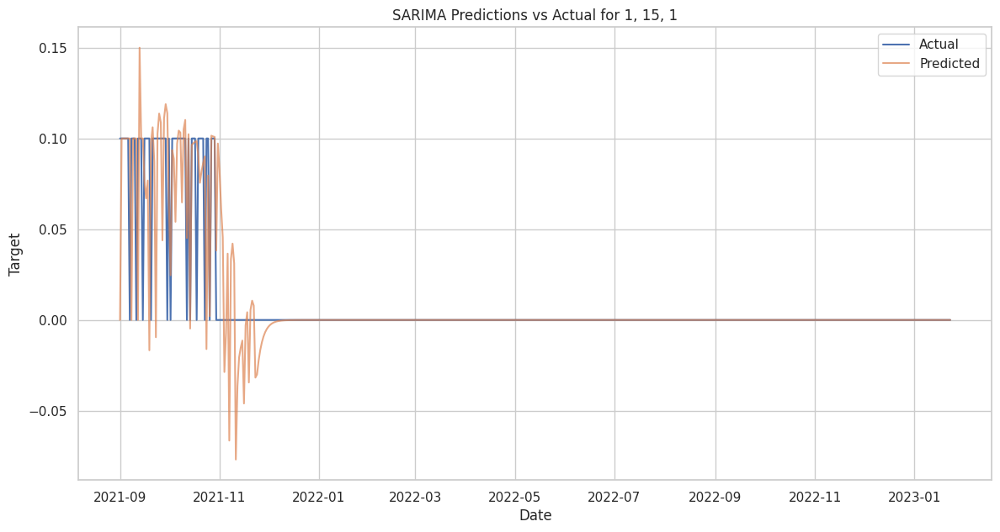

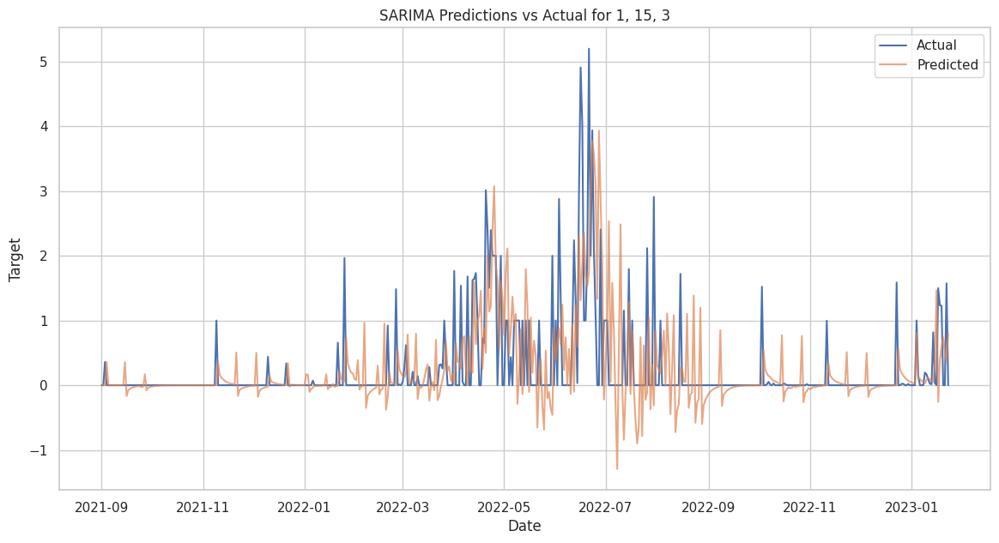

In [ ]:
for (is_business, county, product_type), group in groups:
    # Ensure 'datetime' is the index and reindex if necessary
    group = group.set_index('datetime')
    group = group.asfreq(pd.infer_freq(group.index))

    # Filter by start and end date
    lim_group = group[start_date:end_date]

    # Check if the group has data to model
    if not lim_group.empty and 'target' in lim_group.columns:
        # Fit ARIMA model
        # Adjust the order (p,d,q) as per your analysis
        model = SARIMAX(lim_group['target'],
                order=(1,1,1),
                seasonal_order=(1,1,0,12))
        model_fit = model.fit()

        # Generate predictions
        predictions = model_fit.predict(start=lim_group.index[0], end=lim_group.index[-1])

        # Plot actual vs predicted values
        plt.figure(figsize=(14, 7))
        plt.plot(lim_group.index, lim_group['target'], label='Actual')
        plt.plot(predictions.index, predictions, label='Predicted', alpha=0.7)
        plt.title(f'SARIMA Predictions vs Actual for {is_business}, {county}, {product_type}')
        plt.xlabel('Date')
        plt.ylabel('Target')
        plt.legend()
        plt.show()